In [2]:
import requests
from PIL import Image
import json

In [4]:
SUBSCRIPTION_KEY = 'd81449b6f59a43d7823c6522b464191b'
ENDPOINT = 'https://20210802face.cognitiveservices.azure.com/'

In [5]:
assert SUBSCRIPTION_KEY

In [7]:
face_api_url = ENDPOINT + 'face/v1.0/detect'

In [26]:
img = Image.open('sho1.JPG')

In [39]:
with open('sample.JPG','rb') as f:
    binary_img = f.read()

In [40]:
headers = {
    'content-Type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': SUBSCRIPTION_KEY}

params = {
    'returnFaceId': 'True',
    'returnFaceAttributes':'age,gender,headPose,smile,facialHair,glasses,emotion,hair,makeup'
}

res = requests.post(face_api_url,params = params,
                        headers=headers,data=binary_img)

In [41]:
res

<Response [200]>

In [42]:
result = res.json()
result

[{'faceId': 'aceac811-af17-4978-aa60-37bb461053af',
  'faceRectangle': {'top': 131, 'left': 266, 'width': 85, 'height': 91},
  'faceAttributes': {'smile': 1.0,
   'headPose': {'pitch': -7.1, 'roll': -1.7, 'yaw': 5.0},
   'gender': 'female',
   'age': 23.0,
   'facialHair': {'moustache': 0.0, 'beard': 0.0, 'sideburns': 0.0},
   'glasses': 'NoGlasses',
   'emotion': {'anger': 0.0,
    'contempt': 0.0,
    'disgust': 0.0,
    'fear': 0.0,
    'happiness': 1.0,
    'neutral': 0.0,
    'sadness': 0.0,
    'surprise': 0.0},
   'makeup': {'eyeMakeup': True, 'lipMakeup': True},
   'hair': {'bald': 0.09,
    'invisible': False,
    'hairColor': [{'color': 'black', 'confidence': 0.98},
     {'color': 'brown', 'confidence': 0.83},
     {'color': 'other', 'confidence': 0.45},
     {'color': 'gray', 'confidence': 0.26},
     {'color': 'red', 'confidence': 0.12},
     {'color': 'blond', 'confidence': 0.11},
     {'color': 'white', 'confidence': 0.0}]}}},
 {'faceId': 'ef660a4b-35ab-41cd-aa0d-7372dd4e

In [23]:
rect = result[0]['faceRectangle']
rect

{'top': 1145, 'left': 3509, 'width': 200, 'height': 200}

In [24]:
from PIL import ImageDraw

In [28]:
draw = ImageDraw.Draw(img)

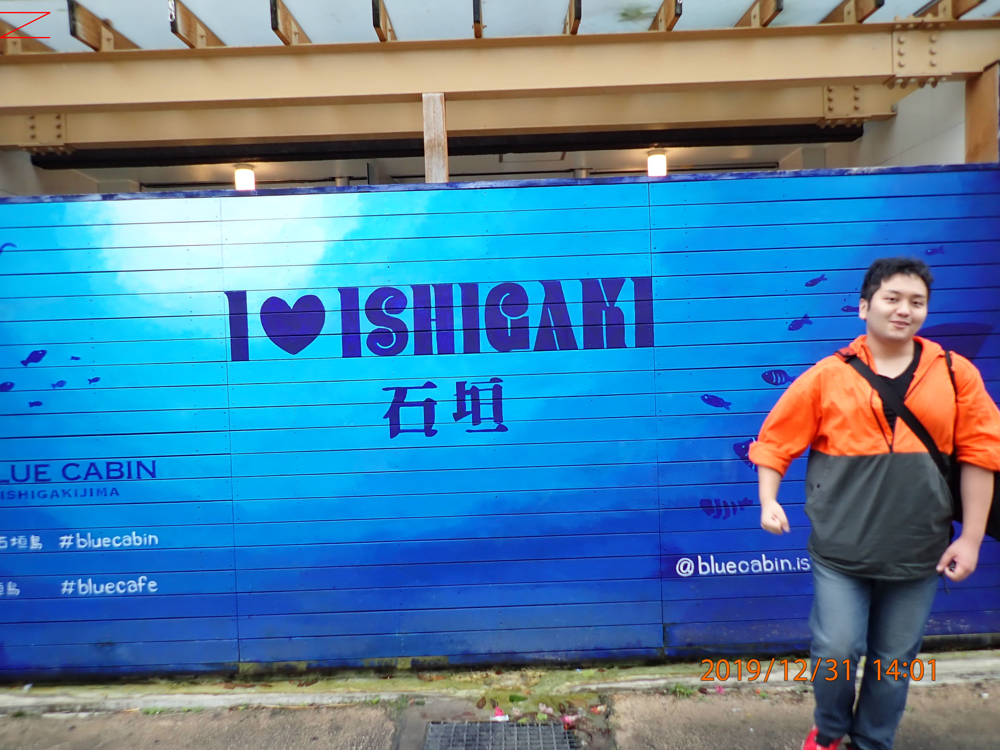

In [31]:
draw.line([(0,50),(200,50),(0,150),(200,150)],fill='red',width=5)
img

In [32]:
img = Image.open('sho1.JPG')

In [34]:
draw = ImageDraw.Draw(img)

In [36]:
draw.rectangle([(rect['left'],rect['top']),(rect['left']+rect['width'],rect['top']+rect['height'])],fill=None,outline='green',width=5)

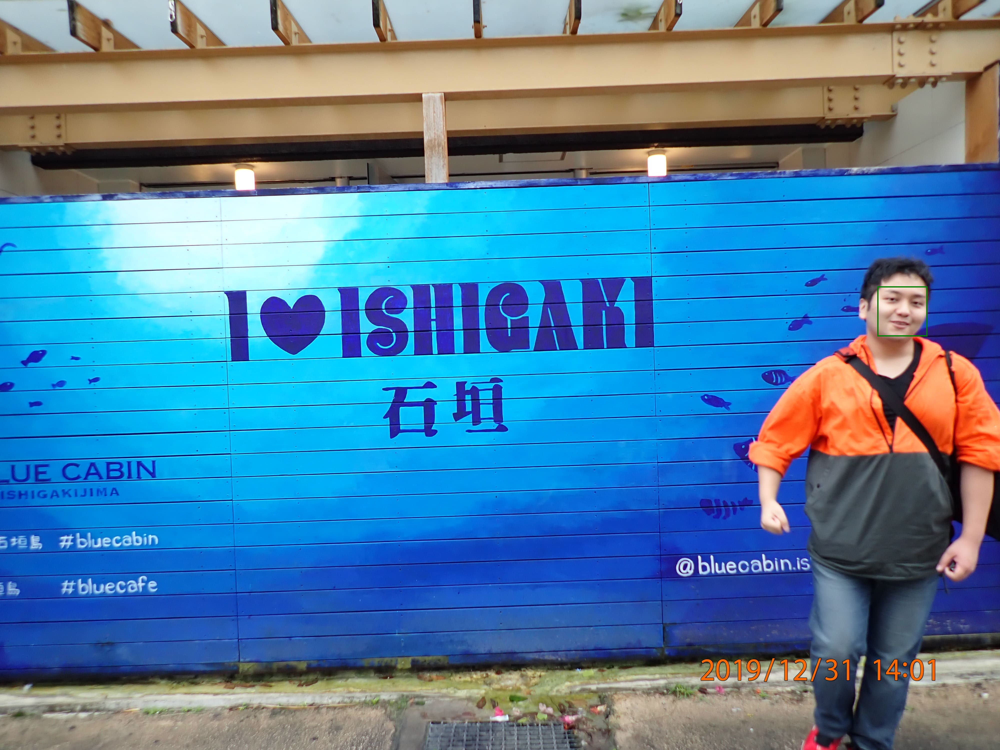

In [37]:
import requests
from PIL import Image
import json
from PIL import ImageDraw

img = Image.open('sho1.JPG')

with open('sho1.JPG','rb') as f:
    binary_img = f.read()

SUBSCRIPTION_KEY = 'd81449b6f59a43d7823c6522b464191b'
ENDPOINT = 'https://20210802face.cognitiveservices.azure.com/'
assert SUBSCRIPTION_KEY

face_api_url = ENDPOINT + 'face/v1.0/detect'

headers = {
    'content-Type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': SUBSCRIPTION_KEY}

params = {
    'returnFaceId': 'True',
    'returnFaceAttributes':'age,gender,headPose,smile,facialHair,glasses,emotion,hair,makeup'
}

res = requests.post(face_api_url,params = params,
                        headers=headers,data=binary_img)

result = res.json()

rect = result[0]['faceRectangle']

draw = ImageDraw.Draw(img)
draw.rectangle([(rect['left'],rect['top']),(rect['left']+rect['width'],rect['top']+rect['height'])],fill=None,outline='green',width=5)

img


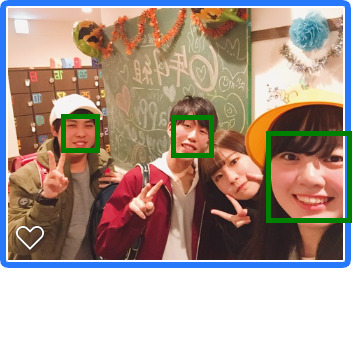

In [44]:
import requests
from PIL import Image
import json
from PIL import ImageDraw
import io



SUBSCRIPTION_KEY = 'd81449b6f59a43d7823c6522b464191b'
ENDPOINT = 'https://20210802face.cognitiveservices.azure.com/'
assert SUBSCRIPTION_KEY

face_api_url = ENDPOINT + 'face/v1.0/detect'

img = Image.open('sample.JPG')
# with open('sample.JPG','rb') as f:
#     binary_img = f.read()
with io.BytesIO() as output:
    img.save(output,format='JPEG')
    binary_img = output.getvalue()  #バイナリ取得

headers = {
    'content-Type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': SUBSCRIPTION_KEY}

params = {
    'returnFaceId': 'True',
    'returnFaceAttributes':'age,gender,headPose,smile,facialHair,glasses,emotion,hair,makeup'
}

res = requests.post(face_api_url,params = params,
                        headers=headers,data=binary_img)

results = res.json()

for result in results:
    rect = result['faceRectangle']

    draw = ImageDraw.Draw(img)
    draw.rectangle([(rect['left'],rect['top']),(rect['left']+rect['width'],rect['top']+rect['height'])],fill=None,outline='green',width=5)

img


In [45]:
import io

In [ ]:
with io.BytesIO() as output:
    img.save(output,format='JPEG')
    binary_img = output.getvalue()  #バイナリ取得